# <p><center style="font-family:newtimeroman;font-size:180%;">Skin Cancer Classification and Quality Evaluation Using Image Analysis </center></p>
### Table of contents:

* [Import Libraries](#1)
* [Read Data](#2)
* [Visualization Of Dataset](#3)
* [Data Augmentation](#4)
* [Train CNN Model](#5)
* [Evaluate The Model](#6)
* [Train CNN Model](#7)
* [Evaluate The Model](#8)
* [Check The Model](#9)

**<a id="1"></a>
# <p style="background-image: url(https://i.postimg.cc/K87ByXmr/stage5.jpg);font-family:camtasia;font-size:120%;color:white;text-align:center;border-radius:15px 50px; padding:7px">Import Libraries </p>
<a class="btn" href="#home">Tabel of Contents</a>

In [1]:
import os 
import cv2
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import LabelEncoder
from tensorflow.keras.preprocessing.image import ImageDataGenerator
import keras 
from keras.callbacks import EarlyStopping,ModelCheckpoint
import tensorflow as tf
from sklearn.metrics import confusion_matrix
from sklearn.metrics import classification_report
from tqdm import tqdm
from imblearn.over_sampling import SMOTE
from sklearn.model_selection import train_test_split

2024-08-10 20:38:00.835928: E external/local_xla/xla/stream_executor/cuda/cuda_dnn.cc:9261] Unable to register cuDNN factory: Attempting to register factory for plugin cuDNN when one has already been registered
2024-08-10 20:38:00.836043: E external/local_xla/xla/stream_executor/cuda/cuda_fft.cc:607] Unable to register cuFFT factory: Attempting to register factory for plugin cuFFT when one has already been registered
2024-08-10 20:38:00.934052: E external/local_xla/xla/stream_executor/cuda/cuda_blas.cc:1515] Unable to register cuBLAS factory: Attempting to register factory for plugin cuBLAS when one has already been registered


**<a id="2"></a>
# <p style="background-image: url(https://i.postimg.cc/K87ByXmr/stage5.jpg);font-family:camtasia;font-size:120%;color:white;text-align:center;border-radius:15px 50px; padding:7px">Read Data </p>
<a class="btn" href="#home">Tabel of Contents</a>

In [2]:
def data(dataset_path):
    images = []
    labels = []
    for folder in os.listdir(dataset_path):
        subfolder_path = os.path.join(dataset_path, folder)
        for subfolder in os.listdir(subfolder_path):
            subfolder_path1 = os.path.join(subfolder_path, subfolder)
            if not os.path.isdir(subfolder_path):
                continue
            for image_filename in os.listdir(subfolder_path1):               
                if image_filename.endswith(".jpg"):
                    image_path = os.path.join(subfolder_path1, image_filename)
                    images.append(image_path)
                    labels.append(subfolder)
    df = pd.DataFrame({'image': images, 'label': labels})
    return df

In [3]:
#train
train=data('/kaggle/input/skin-cancer9-classesisic/Skin cancer ISIC The International Skin Imaging Collaboration')
train.head()

,image,label
0,/kaggle/input/skin-cancer9-classesisic/Skin ca...,pigmented benign keratosis
1,/kaggle/input/skin-cancer9-classesisic/Skin ca...,pigmented benign keratosis
2,/kaggle/input/skin-cancer9-classesisic/Skin ca...,pigmented benign keratosis
3,/kaggle/input/skin-cancer9-classesisic/Skin ca...,pigmented benign keratosis
4,/kaggle/input/skin-cancer9-classesisic/Skin ca...,pigmented benign keratosis


**<a id="3"></a>
# <p style="background-image: url(https://i.postimg.cc/K87ByXmr/stage5.jpg);font-family:camtasia;font-size:120%;color:white;text-align:center;border-radius:15px 50px; padding:7px">Visualization of Dataset </p>
<a class="btn" href="#home">Tabel of Contents</a>

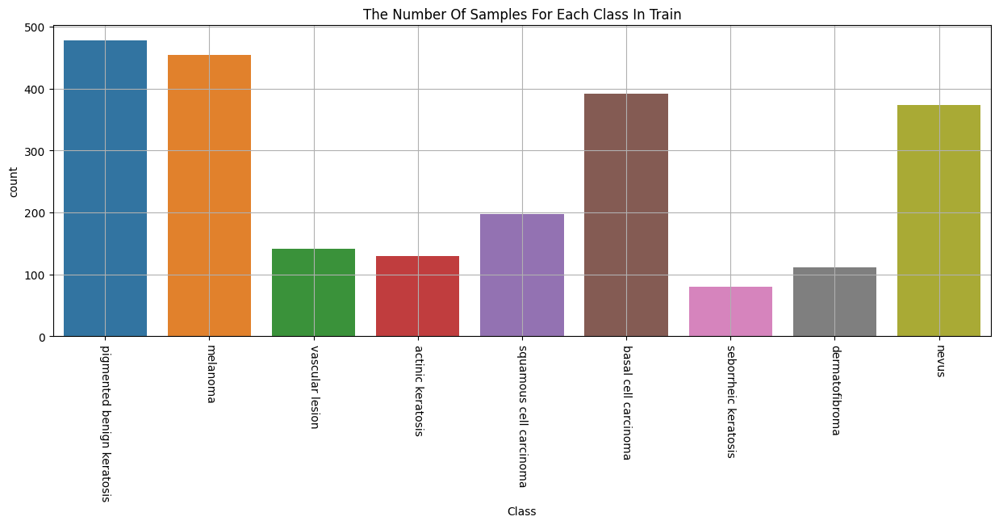

In [4]:
plt.figure(figsize=(15,5))
ax = sns.countplot(x=train.label)
ax.set_xlabel("Class")
plt.title("The Number Of Samples For Each Class In Train")
plt.grid(True)
plt.xticks(rotation=-90)
plt.show()

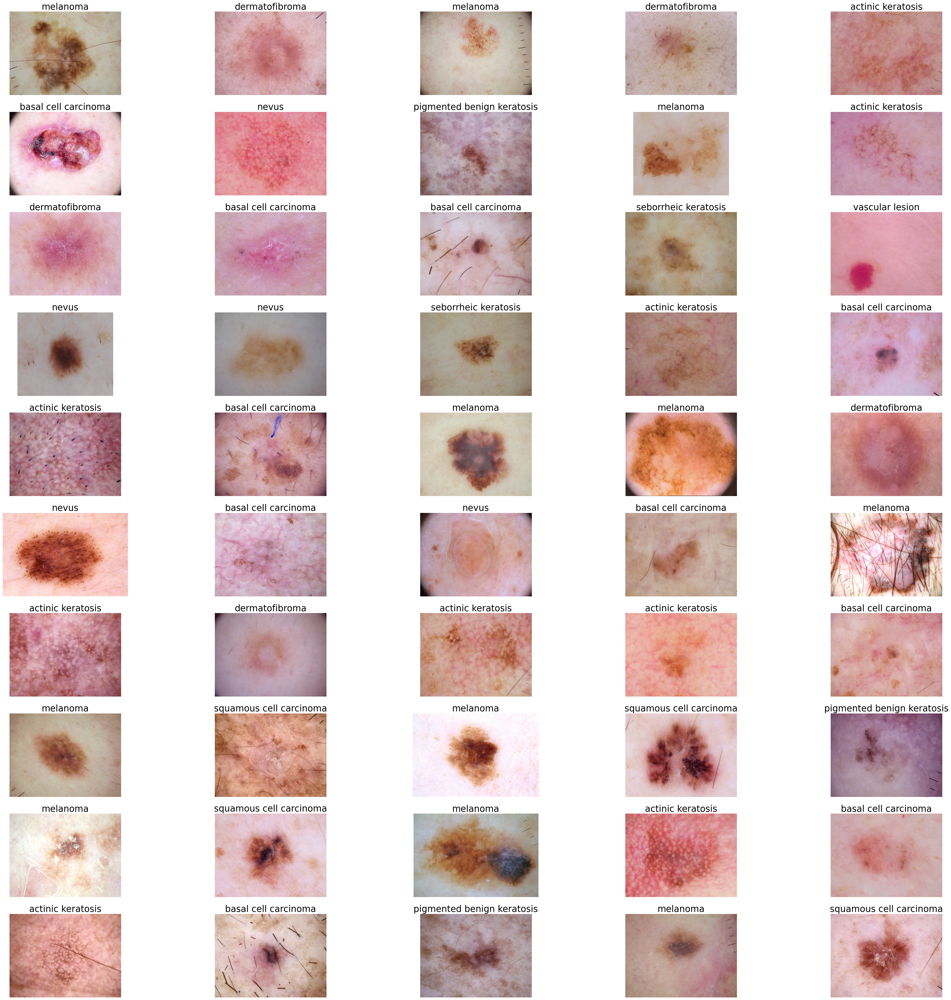

In [5]:
plt.figure(figsize=(50,50))
for n,i in enumerate(np.random.randint(0,len(train),50)):
    plt.subplot(10,5,n+1)
    img=cv2.imread(train.image[i])
    img=cv2.cvtColor(img,cv2.COLOR_BGR2RGB)
    plt.imshow(img)
    plt.axis('off')
    plt.title(train.label[i],fontsize=25)

<a id="4"></a>
# <p style="background-image: url(https://i.postimg.cc/K87ByXmr/stage5.jpg);font-family:camtasia;font-size:120%;color:white;text-align:center;border-radius:15px 50px; padding:7px"> Data Augmentation </p>
<a class="btn" href="#home">Tabel of Contents</a>

In [6]:
df_train,df_test = train_test_split(train,test_size=.2,stratify=train.label,shuffle=True,random_state=41)

In [7]:
image_size = (176, 176)
batch_size = 1700 
datagen = ImageDataGenerator(
    rescale=1./255,
    
)
train_generator = datagen.flow_from_dataframe(
    df_train,
    x_col='image',
    y_col='label',
    target_size=image_size,
    batch_size=batch_size,
    shuffle=True
)
test_generator = datagen.flow_from_dataframe(
    df_test,
    x_col='image',
    y_col='label',
    target_size=image_size,
    batch_size=batch_size,
    shuffle=False
)

Found 1885 validated image filenames belonging to 9 classes.
Found 472 validated image filenames belonging to 9 classes.


In [8]:
train_iter = iter(train_generator)
train_data, train_labels = next(train_iter)

In [9]:
sm = SMOTE(random_state=41)
train_data, train_labels = sm.fit_resample(train_data.reshape(-1, 176 * 176 * 3), train_labels)
train_data = train_data.reshape(-1, 176,176, 3)
print(train_data.shape, train_labels.shape)

(3150, 176, 176, 3) (3150, 9)


In [10]:
class_num=list(train_generator.class_indices.keys())
class_num

['actinic keratosis',
 'basal cell carcinoma',
 'dermatofibroma',
 'melanoma',
 'nevus',
 'pigmented benign keratosis',
 'seborrheic keratosis',
 'squamous cell carcinoma',
 'vascular lesion']

/opt/conda/lib/python3.10/site-packages/seaborn/_oldcore.py:1765: FutureWarning: unique with argument that is not not a Series, Index, ExtensionArray, or np.ndarray is deprecated and will raise in a future version.
  order = pd.unique(vector)


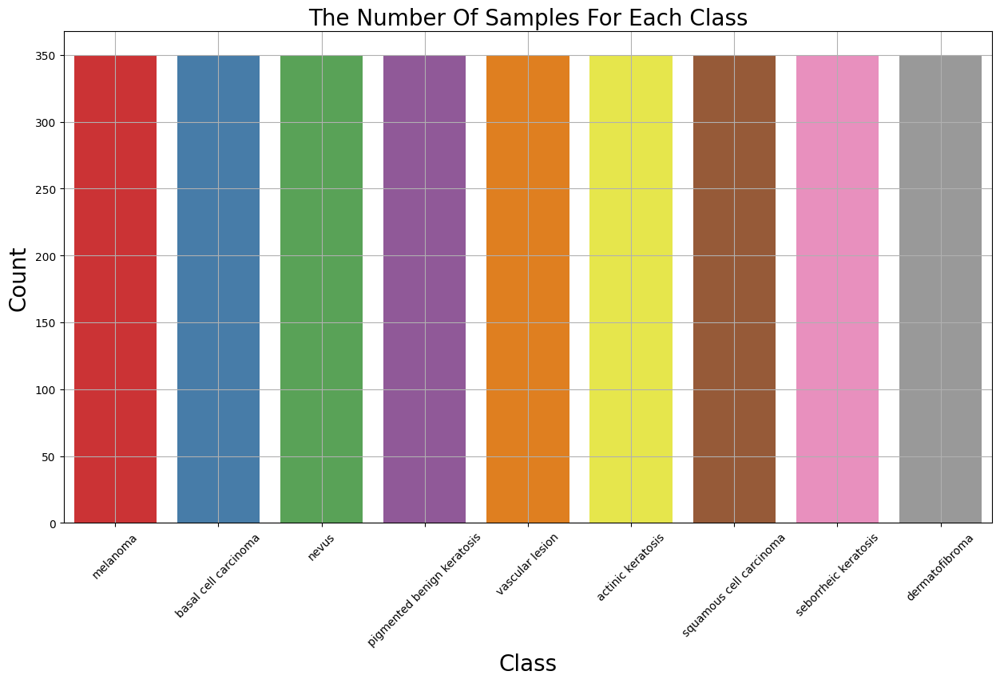

In [11]:
labels=[class_num[i] for i in np.argmax(train_labels,axis=1) ]
plt.figure(figsize=(15,8))
ax = sns.countplot(x=labels,palette='Set1')
ax.set_xlabel("Class",fontsize=20)
ax.set_ylabel("Count",fontsize=20)
plt.title('The Number Of Samples For Each Class',fontsize=20)
plt.grid(True)
plt.xticks(rotation=45)
plt.show()

<a id="5"></a>
# <p style="background-image: url(https://i.postimg.cc/K87ByXmr/stage5.jpg);font-family:camtasia;font-size:120%;color:white;text-align:center;border-radius:15px 50px; padding:7px"> Modeling </p>
<a class="btn" href="#home">Tabel of Contents</a>

In [12]:
model=keras.models.Sequential()
model.add(keras.layers.Conv2D(32,kernel_size=(3,3),strides=2,padding='same',activation='relu',input_shape=(176,176,3)))
model.add(keras.layers.MaxPool2D(pool_size=(2,2),strides=2,padding='same'))
model.add(keras.layers.Conv2D(64,kernel_size=(3,3),strides=2,activation='relu',padding='same'))
model.add(keras.layers.MaxPool2D((2,2),2,padding='same'))
model.add(keras.layers.Conv2D(128,kernel_size=(3,3),strides=2,activation='relu',padding='same'))
model.add(keras.layers.MaxPool2D((2,2),2,padding='same'))
model.add(keras.layers.Flatten())
model.add(keras.layers.Dense(1024,activation='relu'))
model.add(keras.layers.Dropout(0.3))
model.add(keras.layers.Dense(9,activation='softmax'))
model.summary()

/opt/conda/lib/python3.10/site-packages/keras/src/layers/convolutional/base_conv.py:107: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


Model: "sequential"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d (Conv2D)                 │ (None, 88, 88, 32)     │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d (MaxPooling2D)    │ (None, 44, 44, 32)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_1 (Conv2D)               │ (None, 22, 22, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_1 (MaxPooling2D)  │ (None, 11, 11, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_2 (Conv2D)               │ (None, 6, 6, 128)      │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_2 (MaxPooling2D)  │ (None, 3, 3, 128)      │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten (Flatten)               │ (None, 1152)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense (Dense)                   │ (None, 1024)           │     1,180,672 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout (Dropout)               │ (None, 1024)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_1 (Dense)                 │ (None, 9)              │         9,225 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 1,283,145 (4.89 MB)

 Trainable params: 1,283,145 (4.89 MB)

 Non-trainable params: 0 (0.00 B)

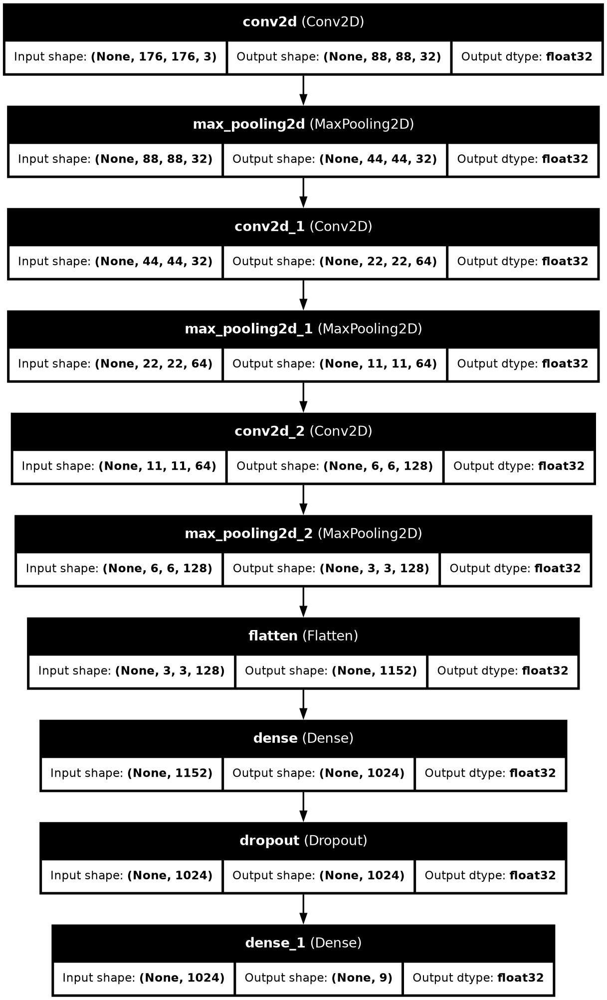

In [13]:
tf.keras.utils.plot_model(model, to_file='model.png', show_shapes=True, show_layer_names=True,show_dtype=True,dpi=120)

In [14]:
checkpoint_cb =ModelCheckpoint("my_keras_model.keras", save_best_only=True)
early_stopping_cb =EarlyStopping(patience=5, restore_best_weights=True)
model.compile(optimizer ='adam', loss='categorical_crossentropy', metrics=['accuracy',keras.metrics.SpecificityAtSensitivity(0.5),keras.metrics.AUC()])
hist=model.fit(train_data,train_labels,validation_split=.1,epochs=50,callbacks=[checkpoint_cb,early_stopping_cb])

Epoch 1/50
13/89 ━━━━━━━━━━━━━━━━━━━━ 1s 13ms/step - accuracy: 0.1135 - auc: 0.5234 - loss: 2.1983 - specificity_at_sensitivity: 0.4857

I0000 00:00:1723322370.378272     100 device_compiler.h:186] Compiled cluster using XLA!  This line is logged at most once for the lifetime of the process.
W0000 00:00:1723322370.401348     100 graph_launch.cc:671] Fallback to op-by-op mode because memset node breaks graph update


89/89 ━━━━━━━━━━━━━━━━━━━━ 0s 99ms/step - accuracy: 0.1319 - auc: 0.5852 - loss: 2.1401 - specificity_at_sensitivity: 0.5698

W0000 00:00:1723322379.074783     100 graph_launch.cc:671] Fallback to op-by-op mode because memset node breaks graph update
W0000 00:00:1723322383.482650      99 graph_launch.cc:671] Fallback to op-by-op mode because memset node breaks graph update


89/89 ━━━━━━━━━━━━━━━━━━━━ 23s 170ms/step - accuracy: 0.1324 - auc: 0.5860 - loss: 2.1392 - specificity_at_sensitivity: 0.5708 - val_accuracy: 0.0000e+00 - val_auc: 0.2264 - val_loss: 2.9664 - val_specificity_at_sensitivity: 0.1563
Epoch 2/50
 1/89 ━━━━━━━━━━━━━━━━━━━━ 3s 38ms/step - accuracy: 0.2500 - auc: 0.7698 - loss: 1.8249 - specificity_at_sensitivity: 0.7852

W0000 00:00:1723322385.259193     101 graph_launch.cc:671] Fallback to op-by-op mode because memset node breaks graph update


89/89 ━━━━━━━━━━━━━━━━━━━━ 1s 13ms/step - accuracy: 0.2870 - auc: 0.7809 - loss: 1.7645 - specificity_at_sensitivity: 0.8214 - val_accuracy: 0.0000e+00 - val_auc: 0.4448 - val_loss: 2.4345 - val_specificity_at_sensitivity: 0.3964
Epoch 3/50
89/89 ━━━━━━━━━━━━━━━━━━━━ 1s 12ms/step - accuracy: 0.3685 - auc: 0.8262 - loss: 1.6142 - specificity_at_sensitivity: 0.8892 - val_accuracy: 0.0444 - val_auc: 0.5064 - val_loss: 2.7968 - val_specificity_at_sensitivity: 0.4472
Epoch 4/50
89/89 ━━━━━━━━━━━━━━━━━━━━ 1s 13ms/step - accuracy: 0.4465 - auc: 0.8657 - loss: 1.4445 - specificity_at_sensitivity: 0.9287 - val_accuracy: 0.4984 - val_auc: 0.8998 - val_loss: 1.2435 - val_specificity_at_sensitivity: 0.9476
Epoch 5/50
89/89 ━━━━━━━━━━━━━━━━━━━━ 1s 12ms/step - accuracy: 0.5151 - auc: 0.8958 - loss: 1.2881 - specificity_at_sensitivity: 0.9461 - val_accuracy: 0.5333 - val_auc: 0.8961 - val_loss: 1.2785 - val_specificity_at_sensitivity: 0.9480
Epoch 6/50
89/89 ━━━━━━━━━━━━━━━━━━━━ 1s 13ms/step - accura

<a id="6"></a>
# <p style="background-image: url(https://i.postimg.cc/K87ByXmr/stage5.jpg);font-family:camtasia;font-size:120%;color:white;text-align:center;border-radius:15px 50px; padding:7px"> Evaluate The Model  </p>
<a class="btn" href="#home">Tabel of Contents</a>

In [15]:
hist_=pd.DataFrame(hist.history)
hist_

,accuracy,auc,loss,specificity_at_sensitivity,val_accuracy,val_auc,val_loss,val_specificity_at_sensitivity
0,0.170018,0.655121,2.056274,0.661640,0.000000,0.226406,2.966373,0.156349
1,0.311464,0.793958,1.723857,0.838713,0.000000,0.444776,2.434513,0.396429
2,0.385891,0.834974,1.582786,0.895855,0.044444,0.506354,2.796766,0.447222
3,0.461728,0.870734,1.422619,0.931790,0.498413,0.899795,1.243457,0.947619
4,0.486067,0.885749,1.341311,0.938492,0.533333,0.896065,1.278476,0.948016
5,0.528395,0.902252,1.246421,0.952293,0.657143,0.946858,0.901420,0.998016
6,0.570018,0.916495,1.150110,0.965035,0.600000,0.949085,0.897609,0.989683
7,0.608466,0.928014,1.070540,0.972354,0.806349,0.983088,0.527658,1.000000
8,0.626808,0.939143,0.984722,0.977072,0.917460,0.997364,0.283512,1.000000
9,0.681834,0.951252,0.880137,0.985582,0.777778,0.980653,0.564804,0.999603


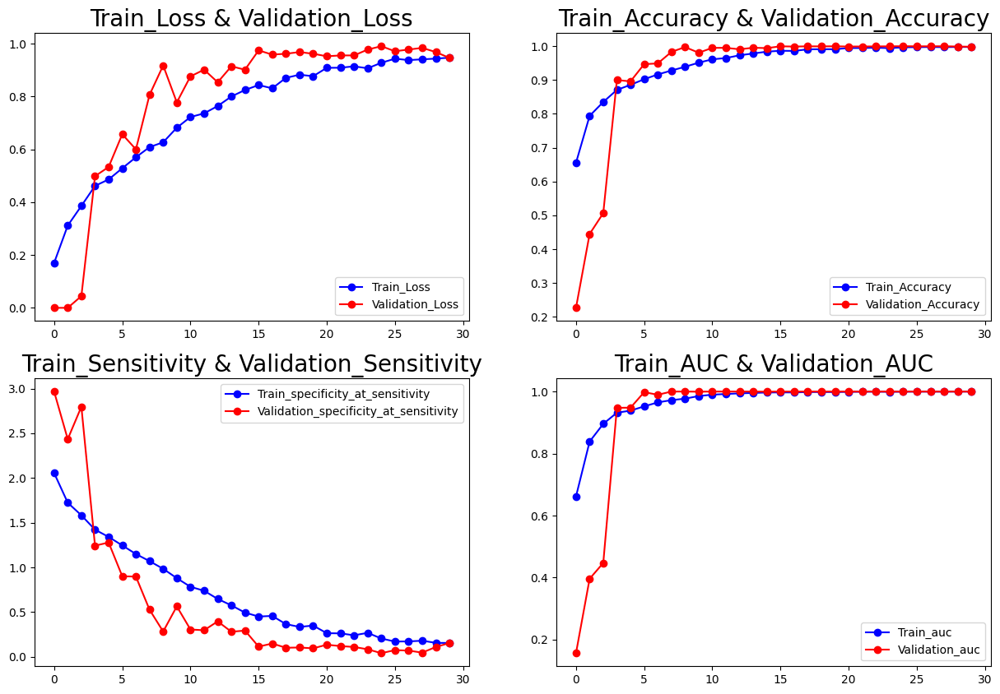

In [16]:
plt.figure(figsize=(15,10))
plt.subplot(2,2,1)
plt.plot(hist_.iloc[:,0],'b-o',label='Train_Loss')
plt.plot(hist_.iloc[:,4],'r-o',label='Validation_Loss')
plt.title('Train_Loss & Validation_Loss',fontsize=20)
plt.legend()
plt.subplot(2,2,2)
plt.plot(hist_.iloc[:,1],'b-o',label='Train_Accuracy')
plt.plot(hist_.iloc[:,5],'r-o',label='Validation_Accuracy')
plt.title('Train_Accuracy & Validation_Accuracy',fontsize=20)
plt.legend()
plt.subplot(2,2,3)
plt.plot(hist_.iloc[:,2],'b-o',label='Train_specificity_at_sensitivity')
plt.plot(hist_.iloc[:,6],'r-o',label='Validation_specificity_at_sensitivity')
plt.title('Train_Sensitivity & Validation_Sensitivity',fontsize=20)
plt.legend()
plt.subplot(2,2,4)
plt.plot(hist_.iloc[:,3],'b-o',label='Train_auc')
plt.plot(hist_.iloc[:,7],'r-o',label='Validation_auc')
plt.title('Train_AUC & Validation_AUC',fontsize=20)
plt.legend()
plt.show()

In [17]:
score, acc,sensitivity,auc = model.evaluate(test_generator)
print('Test Loss =', score)
print('Test Accuracy =', acc)
print('Test Sensitivity =', sensitivity)
print('Test AUC =', auc)

/opt/conda/lib/python3.10/site-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


1/1 ━━━━━━━━━━━━━━━━━━━━ 9s 9s/step - accuracy: 0.5614 - auc: 0.8612 - loss: 2.1591 - specificity_at_sensitivity: 0.9574
Test Loss = 2.159065008163452
Test Accuracy = 0.5614407062530518
Test Sensitivity = 0.9573622941970825
Test AUC = 0.8612080812454224


W0000 00:00:1723322438.715705      99 graph_launch.cc:671] Fallback to op-by-op mode because memset node breaks graph update


<a id="7"></a>
# <p style="background-image: url(https://i.postimg.cc/K87ByXmr/stage5.jpg);font-family:camtasia;font-size:120%;color:white;text-align:center;border-radius:15px 50px; padding:7px"> Modeling </p>
<a class="btn" href="#home">Tabel of Contents</a>

In [18]:
base_model = tf.keras.applications.DenseNet121(
    input_shape=(176, 176, 3),
    include_top=False,
    weights='imagenet'
)
base_model.trainable = False
inputs = tf.keras.Input(shape=(176, 176, 3))
x = base_model(inputs, training=False)
x = keras.layers.Flatten()(x) 
x = keras.layers.Dropout(0.5)(x) 
outputs = keras.layers.Dense(9, activation='softmax')(x)  
model2 = keras.models.Model(inputs, outputs)
model2.summary()

29084464/29084464 ━━━━━━━━━━━━━━━━━━━━ 0s 0us/step


Model: "functional_10"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ input_layer_2 (InputLayer)      │ (None, 176, 176, 3)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ densenet121 (Functional)        │ (None, 5, 5, 1024)     │     7,037,504 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_1 (Flatten)             │ (None, 25600)          │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_1 (Dropout)             │ (None, 25600)          │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_2 (Dense)                 │ (None, 9)              │       230,409 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 7,267,913 (27.72 MB)

 Trainable params: 230,409 (900.04 KB)

 Non-trainable params: 7,037,504 (26.85 MB)

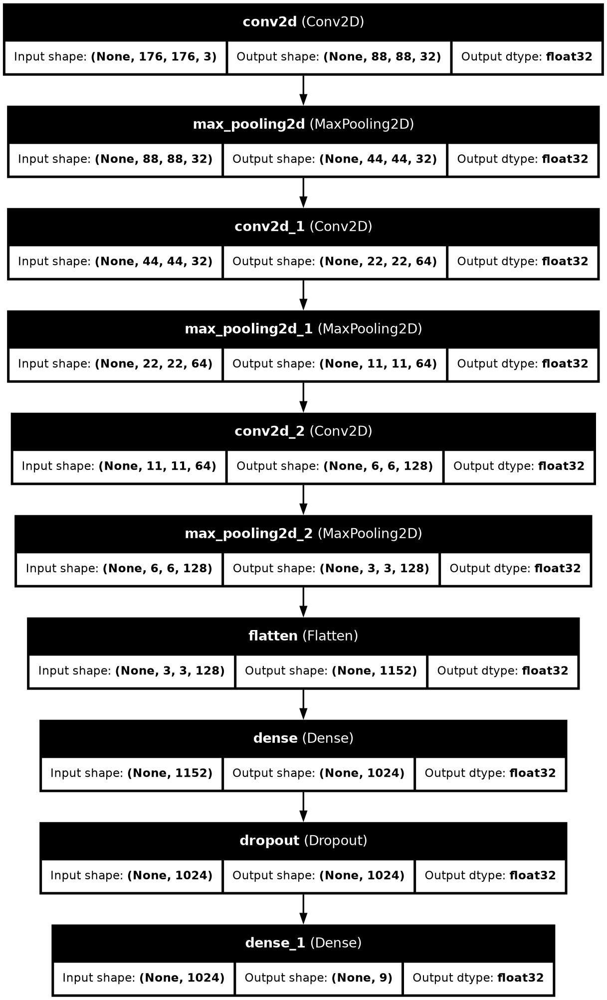

In [19]:
tf.keras.utils.plot_model(model, to_file='model.png', show_shapes=True, show_layer_names=True,show_dtype=True,dpi=120)

In [20]:
checkpoint_cb =ModelCheckpoint("my_keras_model2.keras", save_best_only=True)
early_stopping_cb =EarlyStopping(patience=5, restore_best_weights=True)
model2.compile(optimizer ='adam', loss='categorical_crossentropy', metrics=['accuracy',keras.metrics.SpecificityAtSensitivity(0.5),keras.metrics.AUC()])
hist=model2.fit(train_data,train_labels,validation_split=.1,epochs=50,callbacks=[checkpoint_cb,early_stopping_cb])

Epoch 1/50
 3/89 ━━━━━━━━━━━━━━━━━━━━ 6s 71ms/step - accuracy: 0.0990 - auc_1: 0.5054 - loss: 3.7447 - specificity_at_sensitivity_1: 0.4909

W0000 00:00:1723322489.129586     100 graph_launch.cc:671] Fallback to op-by-op mode because memset node breaks graph update


89/89 ━━━━━━━━━━━━━━━━━━━━ 0s 319ms/step - accuracy: 0.3488 - auc_1: 0.7341 - loss: 2.7382 - specificity_at_sensitivity_1: 0.8184

W0000 00:00:1723322536.166780      99 graph_launch.cc:671] Fallback to op-by-op mode because memset node breaks graph update


89/89 ━━━━━━━━━━━━━━━━━━━━ 115s 819ms/step - accuracy: 0.3500 - auc_1: 0.7350 - loss: 2.7316 - specificity_at_sensitivity_1: 0.8195 - val_accuracy: 0.6444 - val_auc_1: 0.9184 - val_loss: 1.2537 - val_specificity_at_sensitivity_1: 0.9825
Epoch 2/50
89/89 ━━━━━━━━━━━━━━━━━━━━ 6s 72ms/step - accuracy: 0.6311 - auc_1: 0.9210 - loss: 1.2281 - specificity_at_sensitivity_1: 0.9795 - val_accuracy: 0.9111 - val_auc_1: 0.9925 - val_loss: 0.3178 - val_specificity_at_sensitivity_1: 1.0000
Epoch 3/50
89/89 ━━━━━━━━━━━━━━━━━━━━ 5s 58ms/step - accuracy: 0.7050 - auc_1: 0.9521 - loss: 0.9203 - specificity_at_sensitivity_1: 0.9905 - val_accuracy: 0.7905 - val_auc_1: 0.9772 - val_loss: 0.6371 - val_specificity_at_sensitivity_1: 0.9976
Epoch 4/50
89/89 ━━━━━━━━━━━━━━━━━━━━ 5s 59ms/step - accuracy: 0.8047 - auc_1: 0.9722 - loss: 0.6525 - specificity_at_sensitivity_1: 0.9961 - val_accuracy: 0.8571 - val_auc_1: 0.9802 - val_loss: 0.5011 - val_specificity_at_sensitivity_1: 0.9992
Epoch 5/50
89/89 ━━━━━━━━━━━

<a id="8"></a>
# <p style="background-image: url(https://i.postimg.cc/K87ByXmr/stage5.jpg);font-family:camtasia;font-size:120%;color:white;text-align:center;border-radius:15px 50px; padding:7px"> Evaluate The Model  </p>
<a class="btn" href="#home">Tabel of Contents</a>

In [21]:
hist_=pd.DataFrame(hist.history)
hist_

,accuracy,auc_1,loss,specificity_at_sensitivity_1,val_accuracy,val_auc_1,val_loss,val_specificity_at_sensitivity_1
0,0.456437,0.818331,2.145187,0.919356,0.644444,0.918365,1.253720,0.982540
1,0.660317,0.927842,1.164551,0.983466,0.911111,0.992535,0.317826,1.000000
2,0.732275,0.953863,0.891335,0.992240,0.790476,0.977200,0.637105,0.997619
3,0.796473,0.966198,0.723644,0.994885,0.857143,0.980201,0.501119,0.999206
4,0.804233,0.966802,0.728568,0.994709,0.933333,0.996345,0.191669,1.000000
5,0.822575,0.971253,0.653209,0.996252,0.933333,0.994870,0.191997,0.999603
6,0.843739,0.979993,0.530199,0.997972,0.869841,0.984343,0.424637,0.999603
7,0.857848,0.981746,0.494256,0.997751,0.933333,0.994581,0.206223,0.999206
8,0.863492,0.977291,0.542876,0.997663,0.933333,0.994781,0.199103,0.999603
9,0.875838,0.981259,0.486630,0.997355,0.568254,0.841918,2.815705,0.953175


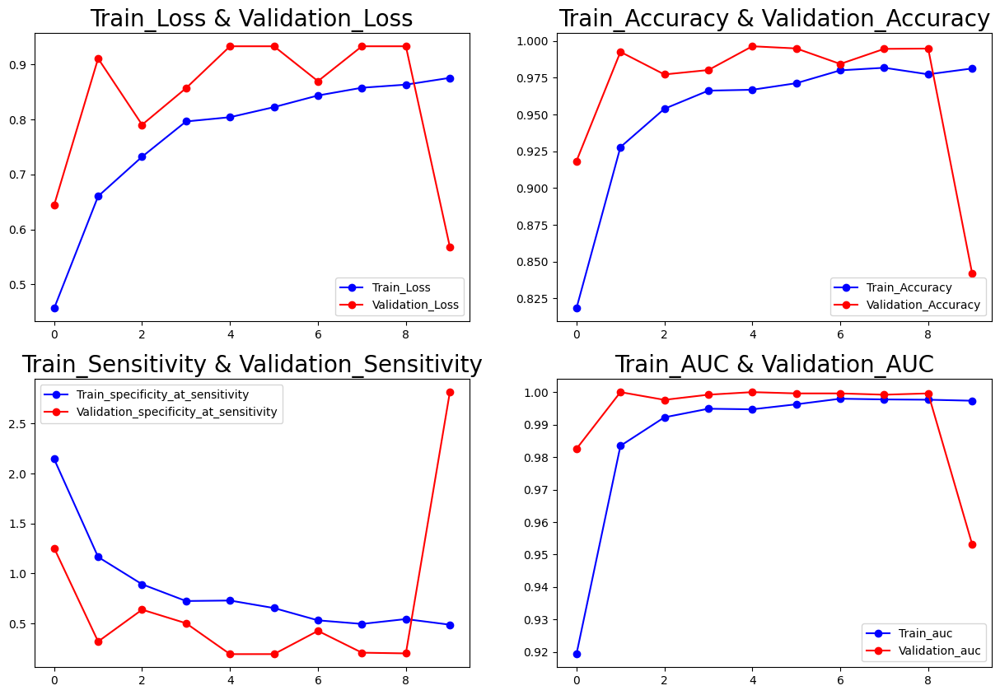

In [22]:
plt.figure(figsize=(15,10))
plt.subplot(2,2,1)
plt.plot(hist_.iloc[:,0],'b-o',label='Train_Loss')
plt.plot(hist_.iloc[:,4],'r-o',label='Validation_Loss')
plt.title('Train_Loss & Validation_Loss',fontsize=20)
plt.legend()
plt.subplot(2,2,2)
plt.plot(hist_.iloc[:,1],'b-o',label='Train_Accuracy')
plt.plot(hist_.iloc[:,5],'r-o',label='Validation_Accuracy')
plt.title('Train_Accuracy & Validation_Accuracy',fontsize=20)
plt.legend()
plt.subplot(2,2,3)
plt.plot(hist_.iloc[:,2],'b-o',label='Train_specificity_at_sensitivity')
plt.plot(hist_.iloc[:,6],'r-o',label='Validation_specificity_at_sensitivity')
plt.title('Train_Sensitivity & Validation_Sensitivity',fontsize=20)
plt.legend()
plt.subplot(2,2,4)
plt.plot(hist_.iloc[:,3],'b-o',label='Train_auc')
plt.plot(hist_.iloc[:,7],'r-o',label='Validation_auc')
plt.title('Train_AUC & Validation_AUC',fontsize=20)
plt.legend()
plt.show()

In [23]:
score, acc,sensitivity,auc = model2.evaluate(test_generator)
print('Test Loss =', score)
print('Test Accuracy =', acc)
print('Test Sensitivity =', sensitivity)
print('Test AUC =', auc)

W0000 00:00:1723322727.056264      99 graph_launch.cc:671] Fallback to op-by-op mode because memset node breaks graph update


1/1 ━━━━━━━━━━━━━━━━━━━━ 108s 108s/step - accuracy: 0.4958 - auc_1: 0.8368 - loss: 2.5678 - specificity_at_sensitivity_1: 0.9396
Test Loss = 2.5678021907806396
Test Accuracy = 0.4957627058029175
Test Sensitivity = 0.9396186470985413
Test AUC = 0.8367878794670105


<a id="9"></a>
# <p style="background-image: url(https://i.postimg.cc/K87ByXmr/stage5.jpg);font-family:camtasia;font-size:120%;color:white;text-align:center;border-radius:15px 50px; padding:7px"> Check The Model  </p>
<a class="btn" href="#home">Tabel of Contents</a>

In [24]:
y_test =test_generator.classes
predictions = model2.predict(test_generator)
y_pred = np.argmax(predictions,axis=1)
y_test = np.ravel(y_test)
y_pred = np.ravel(y_pred)
df = pd.DataFrame({'Actual': y_test, 'Prediction': y_pred})
df

1/1 ━━━━━━━━━━━━━━━━━━━━ 15s 15s/step


,Actual,Prediction
0,5,7
1,4,1
2,4,4
3,3,3
4,8,8
...,...,...
467,5,5
468,3,3
469,5,5
470,6,3


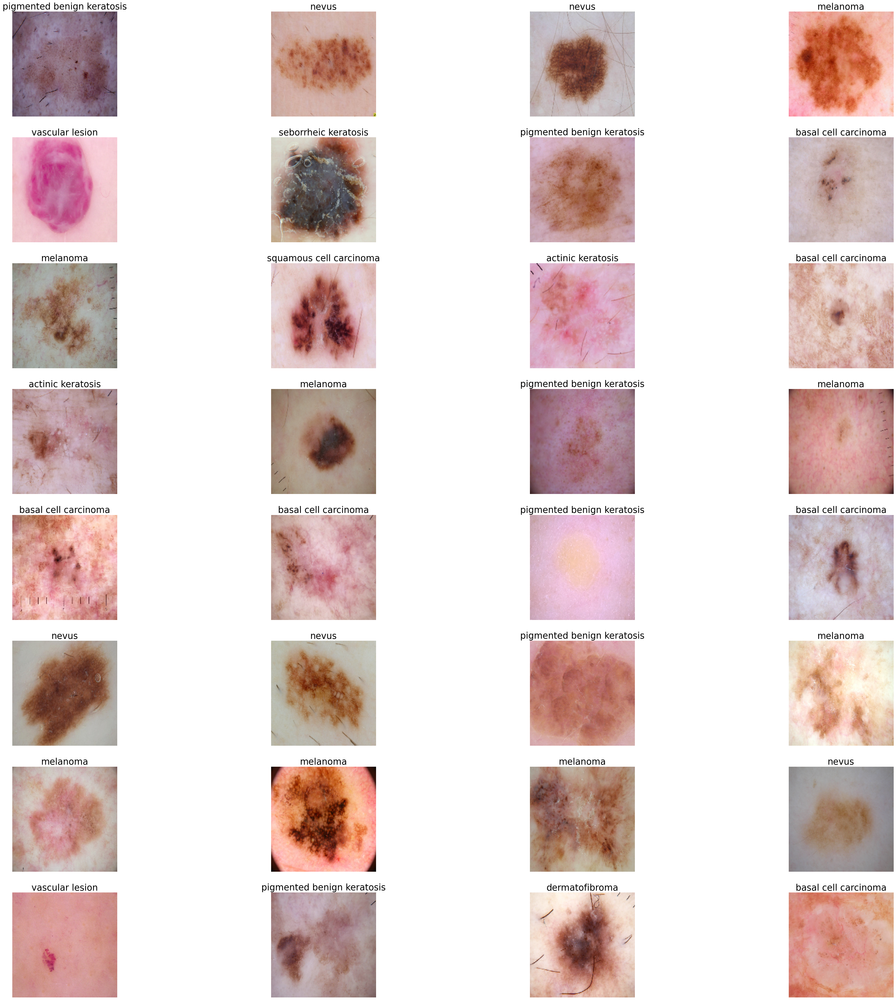

In [25]:
batch = next(test_generator)
images= batch[0]
plt.figure(figsize=(50,50))
for n in range(32):
    plt.subplot(8,4,n+1)
    plt.imshow(images[n])
    plt.axis('off')
    plt.title(class_num[int(y_test[n])],fontsize=25)

array([[ 9,  0,  0,  1,  8,  3,  0,  5,  0],
       [ 5, 48,  1,  7,  0,  5,  0,  8,  5],
       [ 4,  2,  7,  3,  0,  2,  2,  2,  0],
       [ 3,  3,  0, 49,  6,  3, 26,  0,  1],
       [14,  1,  1, 17, 30,  4,  6,  2,  0],
       [13,  7,  0,  8,  5, 46,  6,  8,  3],
       [ 0,  2,  0, 10,  0,  0,  4,  0,  0],
       [ 5,  7,  0,  2,  1,  6,  2, 16,  0],
       [ 0,  2,  0,  0,  1,  0,  0,  0, 25]])

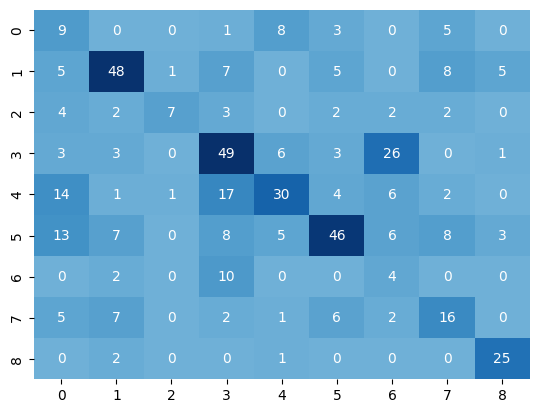

In [26]:
CM = confusion_matrix(y_test,y_pred)
sns.heatmap(CM,fmt='g',center = True,cbar=False,annot=True,cmap='Blues')
CM

In [27]:
ClassificationReport = classification_report(y_test,y_pred)
print('Classification Report is : ', ClassificationReport )

Classification Report is :                precision    recall  f1-score   support

           0       0.17      0.35      0.23        26
           1       0.67      0.61      0.64        79
           2       0.78      0.32      0.45        22
           3       0.51      0.54      0.52        91
           4       0.59      0.40      0.48        75
           5       0.67      0.48      0.56        96
           6       0.09      0.25      0.13        16
           7       0.39      0.41      0.40        39
           8       0.74      0.89      0.81        28

    accuracy                           0.50       472
   macro avg       0.51      0.47      0.47       472
weighted avg       0.56      0.50      0.51       472

